## Load and Collect Entire Data

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
import os 

In [4]:
files = os.listdir(r"C:\Users\HP\Desktop\Numpy and pandas datasets\project datasets\uber-pickups-in-new-york-city-20210729T181845Z-001")[-7:]
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [5]:
files.remove('uber-raw-data-janjune-15.csv')

In [6]:
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [7]:
path = r"C:\Users\HP\Desktop\Numpy and pandas datasets\project datasets\uber-pickups-in-new-york-city-20210729T181845Z-001"

final = pd.DataFrame()
for file in files:
    df=pd.read_csv(path+"/"+file,encoding="utf-8")
    final = pd.concat([final,df])

In [8]:
final.shape

(4534327, 4)

## Data Preparation For Analysis

In [9]:
df = final.copy()

In [10]:
df.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [11]:
df.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

In [12]:
df['Date/Time'] = pd.to_datetime(df['Date/Time'],format = "%m/%d/%Y %H:%M:%S")

In [13]:
df.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
dtype: object

In [14]:
df.head()

,Date/Time,Lat,Lon,Base
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512


In [15]:
df['weekday']=df['Date/Time'].dt.day_name()

In [16]:
df['day']=df['Date/Time'].dt.day

In [17]:
df['minute']=df['Date/Time'].dt.minute
df['month']=df['Date/Time'].dt.month
df['hour']=df['Date/Time'].dt.hour

In [18]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0


In [19]:
df.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
weekday              object
day                   int64
minute                int64
month                 int64
hour                  int64
dtype: object

## Analysing Trips of Uber

### Analysis of Journey by Week-days

In [20]:
import plotly.express as px

In [21]:
px.bar(x=df['weekday'].value_counts().index,
      y=df['weekday'].value_counts()
      )

In [22]:
df['weekday'].value_counts()

Thursday     755145
Friday       741139
Wednesday    696488
Tuesday      663789
Saturday     646114
Monday       541472
Sunday       490180
Name: weekday, dtype: int64

#### So, the conclusion from this insight is on Thursday we have more Crowd.

### Analysis of Journey by Hour

(array([216928., 103517., 227152., 543565., 324851., 366329., 819491.,
        660869., 579117., 692508.]),
 array([ 0. ,  2.3,  4.6,  6.9,  9.2, 11.5, 13.8, 16.1, 18.4, 20.7, 23. ]),
 <a list of 10 Patch objects>)

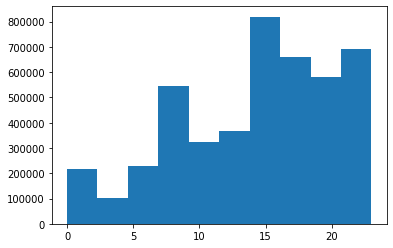

In [23]:
plt.hist(df['hour'])

In [24]:
df['month'].unique()

array([4, 8, 7, 6, 5, 9], dtype=int64)

In [25]:
for i, month in enumerate(df['month'].unique()):
    print(i)
    print(month)

0
4
1
8
2
7
3
6
4
5
5
9


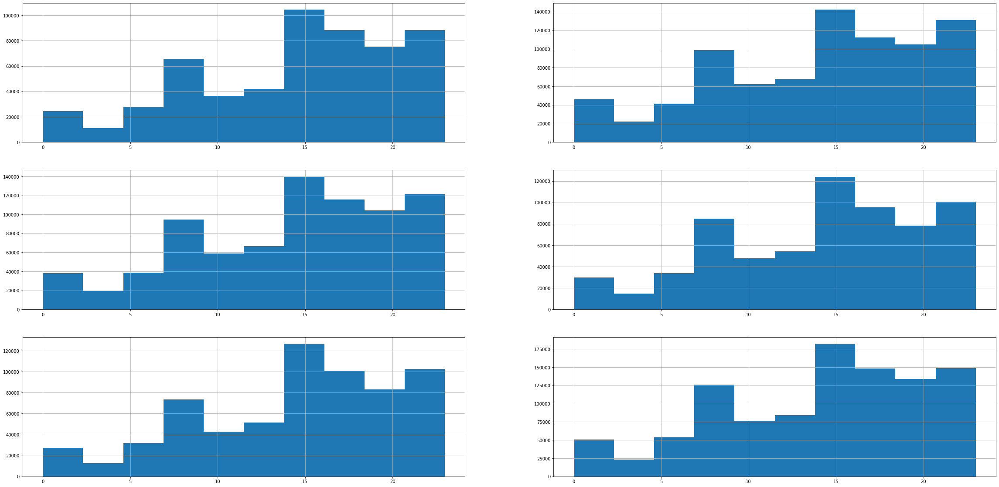

In [26]:
plt.figure(figsize=(40,20))

for i, month in enumerate(df['month'].unique()):
    plt.subplot(3,2,i+1)
    df[df['month'] == month]['hour'].hist()

#### so the conclusion from thses visualizations is almost in each and every month we have a picktime in evening hours. 

### Analysis of which month has max rides

In [27]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0


In [28]:
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [29]:
df.groupby('month')['hour'].count()

month
4     564516
5     652435
6     663844
7     796121
8     829275
9    1028136
Name: hour, dtype: int64

In [30]:
trace1 = go.Bar(
    x = df.groupby('month')['hour'].count().index,
    y = df.groupby('month')['hour'].count(),
    name = 'Priority'
)

In [31]:
iplot([trace1])

#### Conclusion from this insight is 9th month i.e September month has the highest rush which means September has Maximun Rides.

### Analysis of Journey of Each Day 

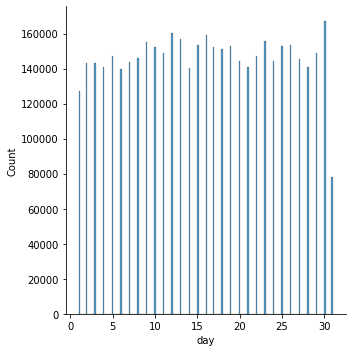

In [32]:
sns.displot(df['day'])

Text(0.5, 1.0, 'Journeys by Month Day')

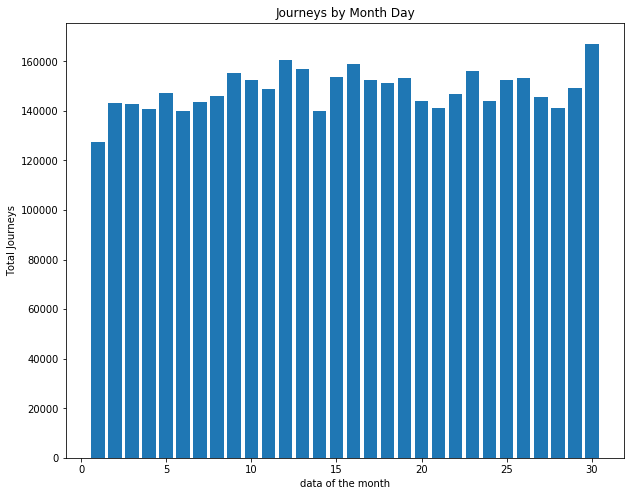

In [33]:
plt.figure(figsize =(10,8))
plt.hist(df['day'],bins=30,rwidth=0.8,range=(0.5,30.5))
plt.xlabel('data of the month')
plt.ylabel('Total Journeys')
plt.title('Journeys by Month Day')

#### On 30th day there are maximum Rides

### Analysis of Total Rides Month Wise 

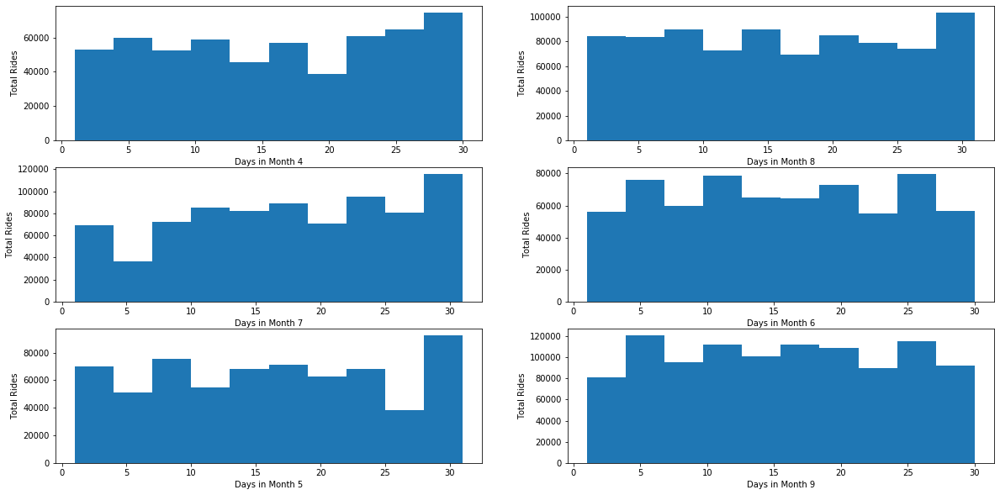

In [34]:
plt.figure(figsize=(20,10))

for i,month in enumerate(df['month'].unique(),1):
    plt.subplot(3,2,i)
    df_out = df[df['month'] == month]
    plt.hist(df_out['day'])
    plt.xlabel('Days in Month {}'.format(month))
    plt.ylabel('Total Rides')

#### The Conclusion From theses Visualization is almost in a couple of last day of each and every month we have maximum Rides.

### Analysing Rush In Hours

Text(0.5, 1.0, 'hoursoffday VS latitude of passenger')

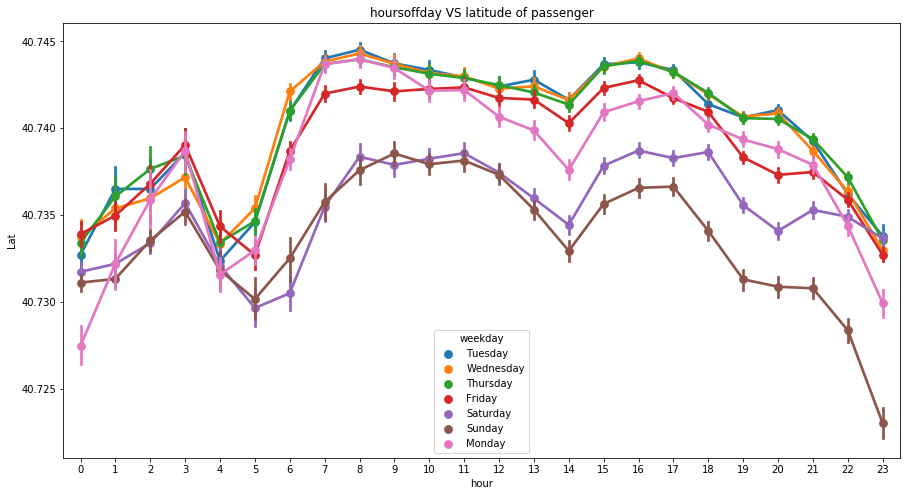

In [35]:
plt.figure(figsize=(15,8))

ax = sns.pointplot(x = 'hour',y = 'Lat',data=df,hue='weekday')
ax.set_title('hoursoffday VS latitude of passenger')

#### From this visualization, we came across the conclusion that on Thursday we have maximum rush as compared to other days , and on sunday we have less rush.

### Analyse which base number gets popular by month name

In [36]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0


In [37]:
base = df.groupby(['Base','month'])['Date/Time'].count().reset_index()
base

,Base,month,Date/Time
0,B02512,4,35536
1,B02512,5,36765
2,B02512,6,32509
3,B02512,7,35021
4,B02512,8,31472
5,B02512,9,34370
6,B02598,4,183263
7,B02598,5,260549
8,B02598,6,242975
9,B02598,7,245597


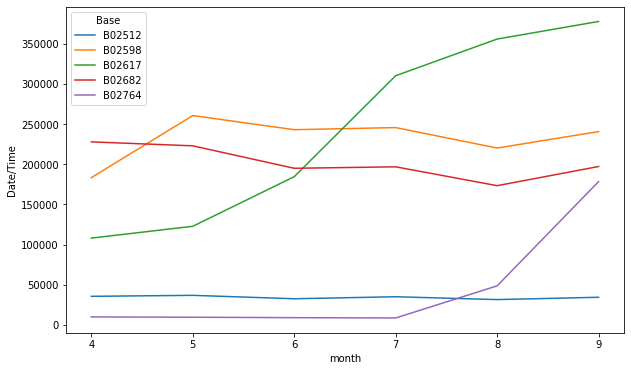

In [38]:
plt.figure(figsize = (10,6))

sns.lineplot(x= 'month',y ='Date/Time',hue='Base',data=base)

#### So, the insights from this lineplot is B02617 gets popular by month name 

### Perform Cross Analysis, Through our exploration we are going to visualize:

#### 1. Heatmap by Hour and Weekday.
#### 2. Heatmap by Hour and Day.
#### 3. Heatmap by Month and Day.
#### 4. Heatmap by Month and Weekday.

In [39]:
def count_rows(rows):
    return len(rows)

In [40]:
by_cross = df.groupby(['weekday','hour']).apply(count_rows)
by_cross

weekday    hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Length: 168, dtype: int64

In [41]:
pivot = by_cross.unstack()
pivot

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
weekday,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


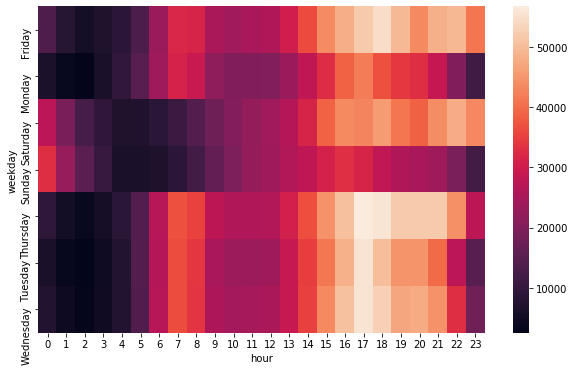

In [42]:
plt.figure(figsize = (10,6))

sns.heatmap(pivot)

#### In evening hours we have more rush.

In [43]:
def heatmap(col1,col2):
    by_cross = df.groupby([col1,col2]).apply(count_rows)
    pivot = by_cross.unstack()
    plt.figure(figsize = (10,6))
    return sns.heatmap(pivot)

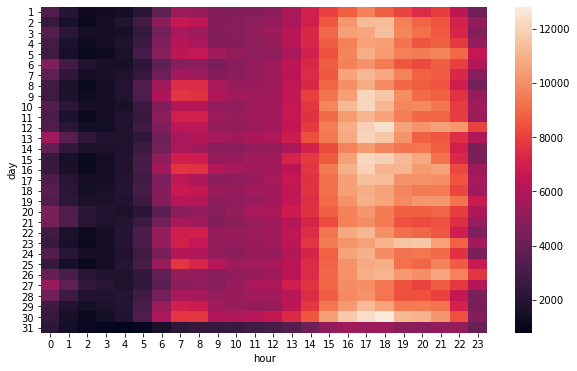

In [44]:
heatmap('day','hour')

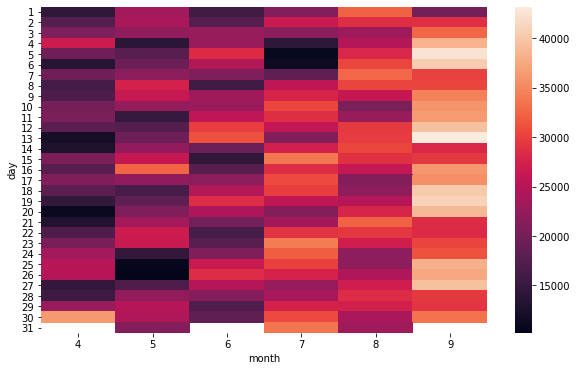

In [45]:
heatmap('day','month')

#### In 9th month, i.e september month  has maximun Rides.

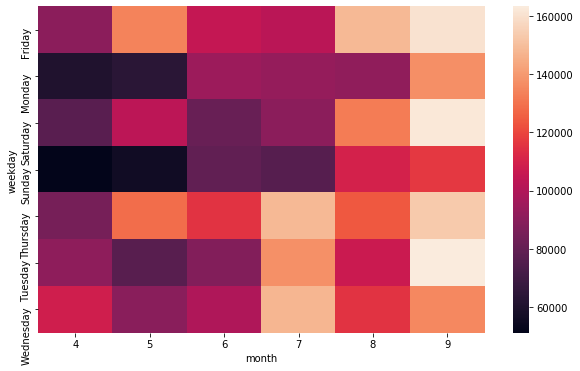

In [46]:
heatmap('weekday','month')

### Analysis of Location Data Points

In [47]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0


(40.6, 41)

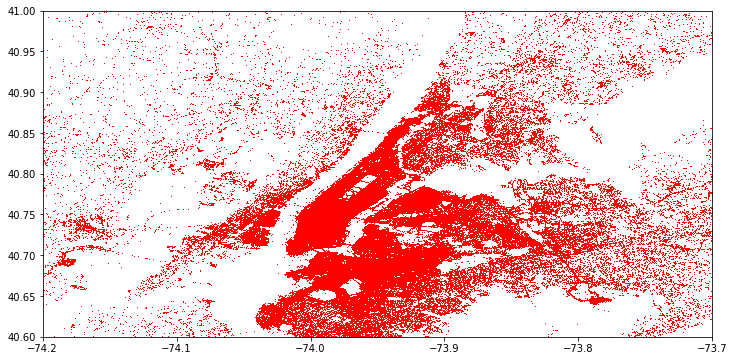

In [48]:
plt.figure(figsize=(12,6))
plt.plot(df['Lon'],df['Lat'],'r+',ms=0.5)
plt.xlim(-74.2,-73.7)
plt.ylim(40.6,41)

#### So, From this visual we come up with the conclusion that In the Darker area there is higher rush, which means we have maximum rides in this region.

#### Perform Spatial Analysis using Heatmap to get a clear cut of Rush.

In [49]:
df_out = df[df['weekday'] == 'Sunday']

In [50]:
df_out.shape

(490180, 9)

In [51]:
df_out.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
6965,2014-04-06 00:00:00,40.6547,-74.3033,B02512,Sunday,6,0,4,0
6966,2014-04-06 00:00:00,40.7356,-74.0006,B02512,Sunday,6,0,4,0
6967,2014-04-06 00:00:00,40.7421,-74.0041,B02512,Sunday,6,0,4,0
6968,2014-04-06 00:00:00,40.7401,-74.0053,B02512,Sunday,6,0,4,0
6969,2014-04-06 00:01:00,40.7368,-73.9877,B02512,Sunday,6,1,4,0


In [52]:
rush = df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index()

In [53]:
rush.columns=['Lat','Lon','no of trips']

In [54]:
rush

,Lat,Lon,no of trips
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1
...,...,...,...
209225,41.3141,-74.1249,1
209226,41.3180,-74.1298,1
209227,41.3195,-73.6905,1
209228,41.3197,-73.6903,1


In [55]:
from folium.plugins import HeatMap

In [56]:
import folium

In [57]:
basemap = folium.Map()

In [58]:
HeatMap(rush,zoom=20,radius=15).add_to(basemap)
basemap

### Automate Your Analysis

In [59]:
def plot(df,day):
    basemap = folium.Map()
    df_out = df[df['weekday'] == day]
    HeatMap(df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index(),zoom=20,radius=15).add_to(basemap)
    return basemap

In [60]:
plot(df,'Saturday')

### Data Preparation

In [61]:
uber_15 = pd.read_csv(r"C:\Users\HP\Desktop\Numpy and pandas datasets\project datasets\uber-pickups-in-new-york-city-20210729T181845Z-001\uber-raw-data-janjune-15.csv")

In [62]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [63]:
uber_15.dtypes

Dispatching_base_num    object
Pickup_date             object
Affiliated_base_num     object
locationID               int64
dtype: object

In [64]:
uber_15['Pickup_date'] = pd.to_datetime(uber_15['Pickup_date'],format = "%Y/%m/%d %H:%M:%S")

In [65]:
uber_15.dtypes

Dispatching_base_num            object
Pickup_date             datetime64[ns]
Affiliated_base_num             object
locationID                       int64
dtype: object

In [66]:
uber_15['weekday']=uber_15['Pickup_date'].dt.day_name()
uber_15['day']=uber_15['Pickup_date'].dt.day
uber_15['minute']=uber_15['Pickup_date'].dt.minute
uber_15['month']=uber_15['Pickup_date'].dt.month
uber_15['hour']=uber_15['Pickup_date'].dt.hour

In [67]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,weekday,day,minute,month,hour
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,47,5,9
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,47,5,9
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,47,5,9
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,47,5,9
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,47,5,9


### Uber Pickups by the month in NYC

In [68]:
px.bar(x = uber_15['month'].value_counts().index,
       y = uber_15['month'].value_counts())

#### So in the 6th month we have a higher number of pickups, and the no. of Uber pickups has been increasing steadily throughout the first half of the 2015 in NY.

### Analysing Rush In New York City

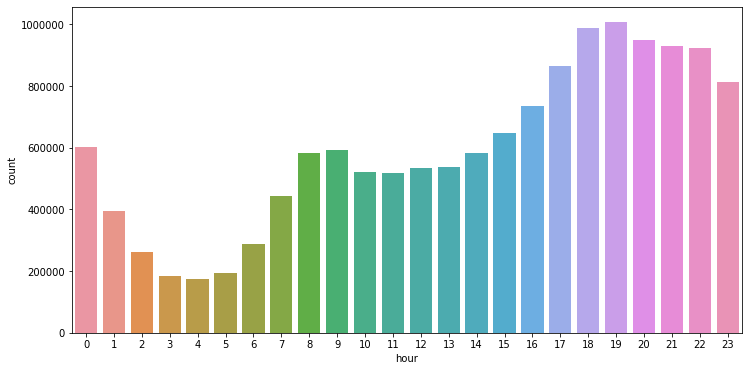

In [69]:
plt.figure(figsize=(12,6))
sns.countplot(x = uber_15['hour'])

#### The insights we are getting from this is like, After the morning Rush the, The number of Uber Pickups doesn't dip much throughout the rest of the morning and in the afternoon as well and there is significantly more demand in the Evening.

### Analysing In-Depth Analysis Of Rush In New York City Day and Hours Wise

In [70]:
summary = uber_15.groupby(['weekday','hour'])['Pickup_date'].count().reset_index()
summary.head()

,weekday,hour,Pickup_date
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


In [71]:
summary.columns=['weekday','hour','count']

In [72]:
summary.head()

,weekday,hour,count
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


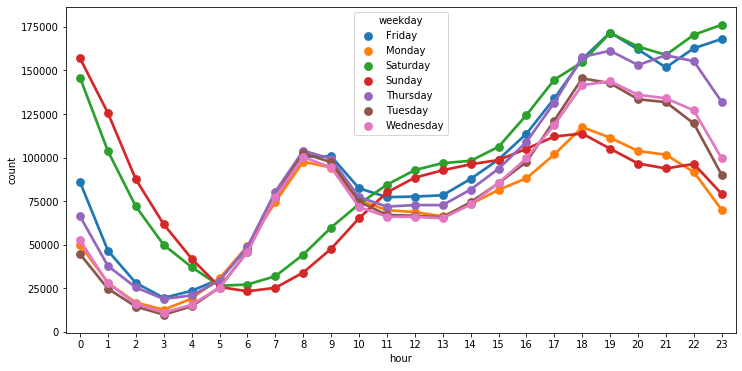

In [73]:
plt.figure(figsize=(12,6))
sns.pointplot(x='hour',y='count',hue='weekday',data=summary)

#### So, The conclusion from this visualization is that on weekends we have more rush depending upon weekdays, but in weekdays we have rush in morning because people are to office at that time.

In [76]:
uber_foil=pd.read_csv(r'C:\Users\HP\Desktop\Numpy and pandas datasets\project datasets\uber-pickups-in-new-york-city-20210729T181845Z-001\Uber-Jan-Feb-FOIL.csv')

In [77]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


In [78]:
uber_foil.shape

(354, 4)

### Analysing which base number has most active vehicles.

In [79]:
uber_foil['dispatching_base_number'].unique()

array(['B02512', 'B02765', 'B02764', 'B02682', 'B02617', 'B02598'],
      dtype=object)

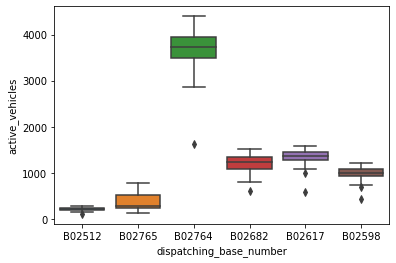

In [80]:
sns.boxplot(x='dispatching_base_number',y='active_vehicles',data=uber_foil)

#### Base No. B02764 has more active vehicles

### Analysing which base number has most trips

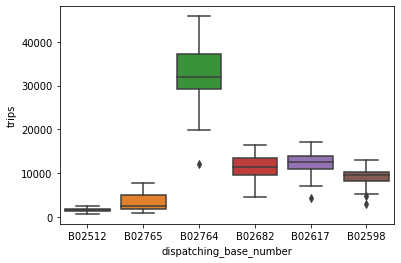

In [81]:
sns.boxplot(x='dispatching_base_number',y='trips',data=uber_foil)

#### Base No. B02764 has most Trips

### How Average trips/vehicles inc/decreasing with dates with each base number?

In [83]:
uber_foil['trips/vehicles']= uber_foil['trips']/uber_foil['active_vehicles']

In [84]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips,trips/vehicles
0,B02512,1/1/2015,190,1132,5.957895
1,B02765,1/1/2015,225,1765,7.844444
2,B02764,1/1/2015,3427,29421,8.585060
3,B02682,1/1/2015,945,7679,8.125926
4,B02617,1/1/2015,1228,9537,7.766287


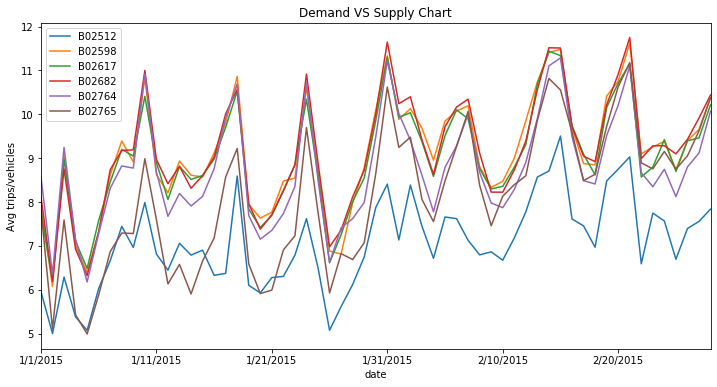

In [87]:
plt.figure(figsize=(12,6))
uber_foil.set_index('date').groupby(['dispatching_base_number'])['trips/vehicles'].plot()
plt.ylabel('Avg trips/vehicles')
plt.title('Demand VS Supply Chart')
plt.legend()

#### The conclusion from this insight is like the two base no. i.e B02764 and B02598 performs better and has more demand whereas, In case of B02512 is not performing well as compared to others.